<a href="https://colab.research.google.com/github/fnikolas-r/DataAnalyticsPortofolio/blob/main/Final_Project_Data_Analytics_ZenPro%20Batch%203.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**TODO**

1. Tambah Data Exploration


<h1>Final Project Data Analytics</h1>

**Brief :**

Laporan ini merupakan bagian dari Final Proyek Studi Independen Zenius Education. Permasalahan yang dibahas pada notebook ini adalah menentukan skor kredit seseorang berdasarkan dataset yang diberikan. Nilai dari skor kredit tersebut bertujuan sebagai penentu layak atau tidaknya calon customer untuk menerima kredit.

Dataset pada notebook ini diperoleh dari [Challange Home Credit Kaggle](https://www.kaggle.com/competitions/home-credit-default-risk/data) yang telah tersimpan pada[ Google Drive local ](https://drive.google.com/drive/u/0/folders/1xvyIhaCYPCmK9-J8HwpUNP73NYKT8SMS)

## Importing Required Library

Untuk akses ke google dan google drive

In [ ]:
!pip install -U -q PyDrive #Untuk menginstall pydrive yang diperlukan dalam mengimpor data dari google drive
!pip install missingno
from pydrive.auth import GoogleAuth #Meminta auntentikasi dari google
from pydrive.drive import GoogleDrive #Meminta akses ke google drive
from google.colab import auth #Meminta auntentikasi dari google dan menghubungkannya ke Collab
from oauth2client.client import GoogleCredentials #Menyimpan credential google yang diperlukan untuk akses google drive
import gc

# Meminta akases ke client google
auth.authenticate_user()
gauth = GoogleAuth()

# Menyimpan credential google dan menyiapkan objek untuk dihubungkan ke GoogleDrive
gauth.credentials = GoogleCredentials.get_application_default()
# Mengakses google drive
drive = GoogleDrive(gauth)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Membuat library untuk visualsisasi dan analisis

In [ ]:
# Analisis dan tabulasi
import pandas as pd

# Untuk visualisasi

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import missingno as mnso
import plotly.figure_factory as ff

# Utuk pengolahan data
import os
import numpy as np

In [ ]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_info_columns', 500)
pd.set_option('display.max_colwidth', 1000)

## Creating Required Functions

In [ ]:
#Fungsi ini untuk melihat persentase data terisi dan kosong
def null_ratio(df, limit=-1):
  percent_missing = df.isnull().sum() * 100 / len(df)
  df_result = pd.DataFrame({
      "filled":df.notnull().sum(),
      "N null":df.isna().sum(),
      "null_ratio(%)": percent_missing,
      }
  )
  nr =  df_result.sort_values("null_ratio(%)",ascending=False)
  return nr[nr["null_ratio(%)"] > limit]


# Data Understanding

Tahap ini bertujuan untuk memahami dataset yang diberikan serta mendapatkan insight yang dapat membantu pemodelan nantinya

### Importing Dataset

Ini adalah tahapan untuk mengambil dataset yang diperlukan. Tahapan ini meliputi pengelolaan penyimpanan pada dataset serta metode untuk mengambil dataset tersebut

Variabel constant untuk akses dataset

In [ ]:
DATA = {
    'application_train.csv':"1pfYYVnfI3Yj5vCIXf7MFuuCEf9uxAMmg",
    'application_test.csv':"1jqKTn3XAvIJ3UBRPDjIE0a6U0EH-LNdZ",
    'bureau_balance.csv':"15ubAZi1jggwZs7GOVQ-lFO5aZt86FbIB",
    'bureau.csv':"15HAhnp53juB25vDYAyzcmL6tyL2rrD0M",
    'credit_card_balance.csv':"1uLa7F_aRfYRWqem8Z_VirBBYBEKc3LZe",
    'credit_card_balance.csv':"1uLa7F_aRfYRWqem8Z_VirBBYBEKc3LZe",
    'installments_payments.csv':"19exgMoLcK0CQbNsMvAa21XP5_G--6f-N",
    'POS_CASH_balance.csv':"1ZyhlnIgvEceJTkpphJ3YAWN22pcS2eeI",
    'previous_application.csv':"1nxxSDgLkAGDDx-7EkxR7hYCSSmY4Hvrg",
    "Column_desc.csv":"1UF2Ti5QFy0g3RP_q68xp2AZ7YBBD33nv"
}

In [ ]:
# untuk mengunduh file ke dalam storage runtimme
def get_file(content_id,filename):
    if os.path.exists(filename):
        return True

    downloaded = drive.CreateFile({'id':content_id})
    downloaded.GetContentFile(filename)

In [ ]:
# Proses pengunduhan
for name,id in DATA.items():
    get_file(id,name)

In [ ]:
# Menyimpan dataset dalam dataframe
df_train = pd.read_csv('application_train.csv')
df_test = pd.read_csv('application_test.csv')
df_cash_balance = pd.read_csv('POS_CASH_balance.csv')
df_bureau = pd.read_csv('bureau.csv')
df_bureau_balance = pd.read_csv('bureau_balance.csv')
df_CC_balance = pd.read_csv('credit_card_balance.csv')
df_inst_payment = pd.read_csv('installments_payments.csv')
df_prev_app = pd.read_csv('previous_application.csv')
df_desc = pd.read_csv('Column_desc.csv', encoding = "ISO-8859-1")

## Describe Data
Pada tahap ini kita akan melakukan deskripsi terhadap dataset yang ada meliputi kolom-kolom yang ada, nama tabel, join tabel, contoh isi data pada tabel, dan sebagainya.

<img src="https://storage.googleapis.com/kaggle-media/competitions/home-credit/home_credit.png" width="80%">


https://www.kaggle.com/c/home-credit-default-risk/discussion/57750

In [ ]:
df_desc.query('Table.str.contains("train")', engine='python')

**HomeCredit_columns_description.csv**

    This file contains descriptions for the columns in the various data files.

In [ ]:
DATA = {
    "df_train":df_train,
    "df_test":df_test,
    "df_cash_balance":df_cash_balance,
    "df_bureau":df_bureau,
    "df_bureau_balance":df_bureau_balance,
    "df_CC_balance":df_CC_balance,
    "df_inst_payment":df_inst_payment,
    "df_prev_app":df_prev_app,
}

In [ ]:
# Pertama-tama kita perlu melihat isi data untuk keseluruhan dataset
print("(baris, kolom)")
for key,d in DATA.items():
    print(d.shape,"==>",key)

# Mengatasi performance issue
del(DATA)

(baris, kolom)
(307511, 122) ==> df_train
(48744, 121) ==> df_test
(10001358, 8) ==> df_cash_balance
(1716428, 17) ==> df_bureau
(27299925, 3) ==> df_bureau_balance
(3840312, 23) ==> df_CC_balance
(13605401, 8) ==> df_inst_payment
(1670214, 37) ==> df_prev_app


### Describe Table

**application_{train|test}.csv**

    Ini adalah tabel utama yang terdiri dari data training (dengan TARGET) dan testing (tanpa kolom TARGET).
    Data bersifat statis (tidak berubah) dan setiap barisnya menjelaskan mengneai data pinjaman (loan).

In [ ]:
df_train.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [ ]:
null_ratio(df_train, 0)

----------------------




**bureau.csv**

    Berisi data nasabah yang tercatat di institusi finansial lainnya. Data tersebut diperoleh dari Biro Kredit.
    Setiap baris berisi data kredit pada perusahaan lain untuk calon nasabah sebelum pengajuan.
    (Bila ada 2 perusahaan maka akan terdapat dua kolom)


In [ ]:
df_bureau.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


In [ ]:
null_ratio(df_bureau,0)

,filled,N null,null_ratio(%)
AMT_ANNUITY,489637,1226791,71.473490
AMT_CREDIT_MAX_OVERDUE,591940,1124488,65.513264
DAYS_ENDDATE_FACT,1082775,633653,36.916958
AMT_CREDIT_SUM_LIMIT,1124648,591780,34.477415
AMT_CREDIT_SUM_DEBT,1458759,257669,15.011932
DAYS_CREDIT_ENDDATE,1610875,105553,6.149573
AMT_CREDIT_SUM,1716415,13,0.000757


--------------


**bureau_balance.csv**

    Berisi -balance- tiap bulan untuk setiap data nasabah yang tercatat di Credit Bureau (tabel bureau).
    Setiap data pada kolom ini berisi mengnenai histori balance nasabah per -X balancenya.
    Status pada kolom ini menyatakan berapa lama customer tersebut memiliki utang tertunggak.


In [ ]:
df_bureau_balance.head()
# DPD status adalah status berapa lama utang tertunggak (days pays due)

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [ ]:
null_ratio(df_bureau_balance, 0)

,filled,N null,null_ratio(%)


-------------------


**POS_CASH_balance.csv**

    Berisi snapshot nasabah dari POS (point of sale) dan kredit kas pada peminjaman nasabah sebelumnya di Home Credit.


In [ ]:
# Melihat kolom traning
df_cash_balance.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


In [ ]:
null_ratio(df_cash_balance,0)

,filled,N null,null_ratio(%)
CNT_INSTALMENT_FUTURE,9975271,26087,0.260835
CNT_INSTALMENT,9975287,26071,0.260675


-----------


**credit_card_balance.csv**

    Berisi snapshot balance Credit Card yang dimiliki oleh calon kreditur.
    Tabel ini mencatat balance tiap bulannya.


In [ ]:
df_CC_balance.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.0,1800.0,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.0,2250.0,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.0,2250.0,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.0,11925.0,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.0,27000.0,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


In [ ]:
null_ratio(df_CC_balance, 0)

,filled,N null,null_ratio(%)
AMT_PAYMENT_CURRENT,3072324,767988,19.998063
AMT_DRAWINGS_ATM_CURRENT,3090496,749816,19.524872
CNT_DRAWINGS_POS_CURRENT,3090496,749816,19.524872
AMT_DRAWINGS_OTHER_CURRENT,3090496,749816,19.524872
AMT_DRAWINGS_POS_CURRENT,3090496,749816,19.524872
CNT_DRAWINGS_OTHER_CURRENT,3090496,749816,19.524872
CNT_DRAWINGS_ATM_CURRENT,3090496,749816,19.524872
CNT_INSTALMENT_MATURE_CUM,3535076,305236,7.948208
AMT_INST_MIN_REGULARITY,3535076,305236,7.948208


---------------


**previous_application.csv**

    Berisi pengajuan yang pernah dikirimkan oleh nasabah mengenai
    Home Credit serta berapa banyak pinjaman yang dimiliki oleh client.


In [ ]:
df_prev_app.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
null_ratio(df_prev_app,0)

--------------


**installments_payments.csv**

    Riwayat pembayaran kredit pada pengajuan Home Credit sebelumnya.
    Pada tabel ini terdiri kolom pembayaran kredit dan pembayaran yang tertunggak.



In [ ]:
df_inst_payment.head()

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


In [ ]:
null_ratio(df_inst_payment,0)

,filled,N null,null_ratio(%)
DAYS_ENTRY_PAYMENT,13602496,2905,0.021352
AMT_PAYMENT,13602496,2905,0.021352


## Explore Data

### Visualisasi Sebelum Cleaning

In [ ]:
# @title Banyaknya Train vs Banyaknya Test
px.pie(
    pd.DataFrame({
    "table":["train","test"],
    "size":[len(df_train), len(df_test)]
    }),
    values="size",names="table"
)

In [ ]:
#@title Melihat Apakah Target Seimbang atau tidak
# Untuk melihat unique value kolom "TARGET"
print(df_train.TARGET.unique())
y_value_counts = df_train['TARGET'].value_counts()
print("Number of customers who will not repay the loan on time: ", y_value_counts[1], ", (", (y_value_counts[1]/(y_value_counts[1]+y_value_counts[0]))*100,"%)")
print("Number of customers who will repay the loan on time: ", y_value_counts[0], ", (", (y_value_counts[0]/(y_value_counts[1]+y_value_counts[0]))*100,"%)")

print("Terlihat bahwa dataset tidak seimbang dan lebih didominasi oleh 'Will Repay'")
px.pie(df_train,names=df_train.TARGET.map({0:"Will Repay",1:"Will Not Repay"}))

[1 0]
Number of customers who will not repay the loan on time:  24825 , ( 8.072881945686495 %)
Number of customers who will repay the loan on time:  282686 , ( 91.92711805431351 %)
Terlihat bahwa dataset tidak seimbang dan lebih didominasi oleh 'Will Repay'


In [ ]:
# @title Perbandingan Jenis Kelamin Laki-Laki dan Perempuan
px.histogram(df_train, x="CODE_GENDER",color=df_train.TARGET.map({0:"Will Repay",1:"Will Not Repay"}))

In [ ]:
#@title Siapa yang mengantarkan Client?
px.histogram(df_train,x="NAME_TYPE_SUITE",color="TARGET")

In [ ]:
#@title Jenis Pinjaman
plot = px.pie(df_train,names="NAME_CONTRACT_TYPE",
              title="Perbandingan Jenis Pinjaman")
plot.show()
plot = px.histogram(df_train,x="NAME_CONTRACT_TYPE",
                    color="TARGET", title="Perbandingan Jenis Pinjaman")
plot.show()
del plot

In [ ]:
#@title Jenis Sumber Pendapatan Client
plot = px.histogram(df_train, y="NAME_INCOME_TYPE",color="TARGET",
                    title="APPLICANT INCOME TYPE").update_layout(
                        yaxis={'categoryorder':'total ascending'})
plot.show()
plot = px.pie(df_train, names="NAME_INCOME_TYPE")
plot.show()

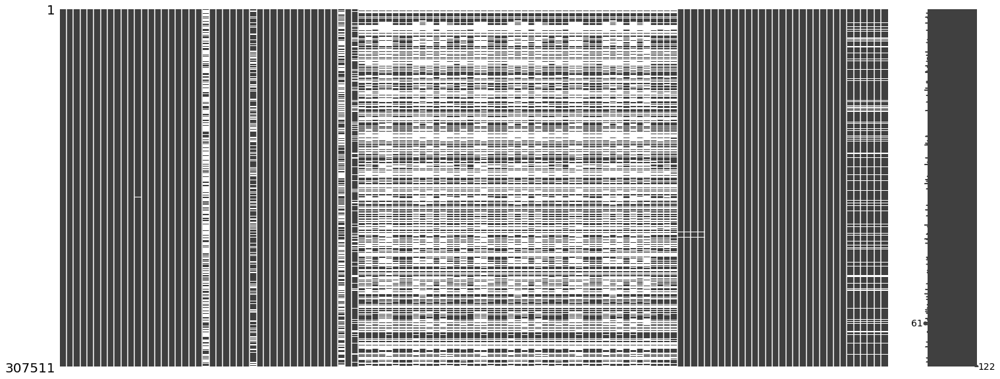

In [ ]:
#@title Distribusi Missing Value
mnso.matrix(df_train)

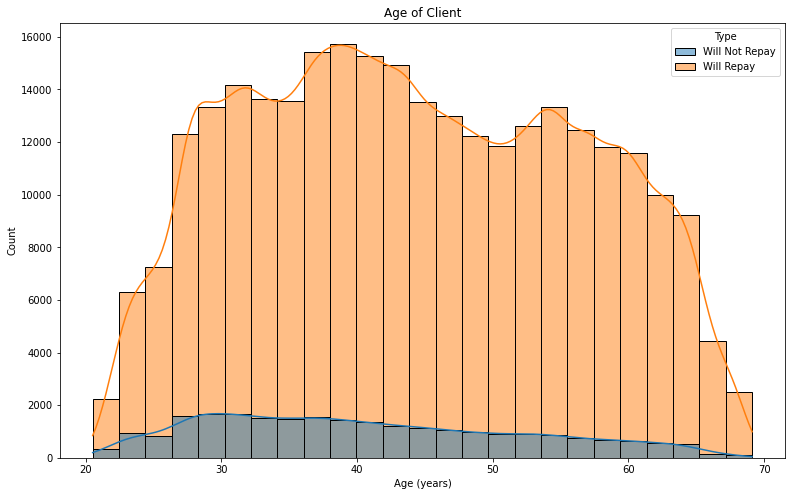

In [ ]:
#@title Distribusi Umur Client
def age_client():
    df = pd.DataFrame()
    df["AGE"] = df_train['DAYS_BIRTH']/-365
    df["Type"] = df_train["TARGET"].map({0:"Will Repay",1:"Will Not Repay"})
    plt.figure(figsize=(13,8))
    plt.title('Age of Client'); plt.xlabel('Age (years)'); plt.ylabel('Count');
    sns.histplot(data=df, x="AGE",hue="Type", bins=25, kde=True)
    px.histogram(df, x="AGE",color="Type", nbins=25,marginal="box",).show()
age_client()

- Sebagian besar orang yang mengajukan pinjaman berada di kisaran (35-40) tahun sedangkan ini diikuti oleh orang-orang di kisaran (40-45) tahun sedangkan jumlah pemohon pada orang berusia <25 atau usia> 65 sangat rendah.

-Orang-orang dalam kelompok usia yang sama (35-40) tahun dan (40-45) tahun dianggap paling mampu.

-Orang yang berusia (25-30) tahun dan (30-35) tahun memiliki peluang besar untuk dianggap tidak mampu membayar pinjaman.



In [ ]:
def plot_stats(feature,label_rotation=False,horizontal_layout=True):
    temp = df_train[feature].value_counts()
    dfnc = pd.DataFrame({feature: temp.index,'Number of contracts': temp.values})

    # Calculate the percentage of target=1 per category value
    cat_perc = df_train[[feature, 'TARGET']].groupby([feature],as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)

    if(horizontal_layout):
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,6))
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12,14))
    sns.set_color_codes("pastel")
    s = sns.barplot(ax=ax1, x = feature, y="Number of contracts",data=dfnc)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    s = sns.barplot(ax=ax2, x = feature, y='TARGET', order=cat_perc[feature], data=cat_perc)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    plt.ylabel('Persentase Client tidak sanggup membayar (Target=1) [%]', fontsize=10)
    plt.tick_params(axis='both', which='major', labelsize=10)
    plt.show();

In [ ]:
def plot_distribution(var):

    i = 0
    t1 = df_train[df_train['TARGET'] != 0]
    t0 = df_train.loc[df_train['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(2,2,figsize=(12,12))

    for feature in var:
        i += 1
        plt.subplot(2,2,i)
        sns.kdeplot(t1[feature], bw=0.5,label="TARGET = 1")
        sns.kdeplot(t0[feature], bw=0.5,label="TARGET = 0")
        plt.ylabel('Density plot', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        locs, labels = plt.xticks()
        plt.tick_params(axis='both', which='major', labelsize=12)
    plt.show();

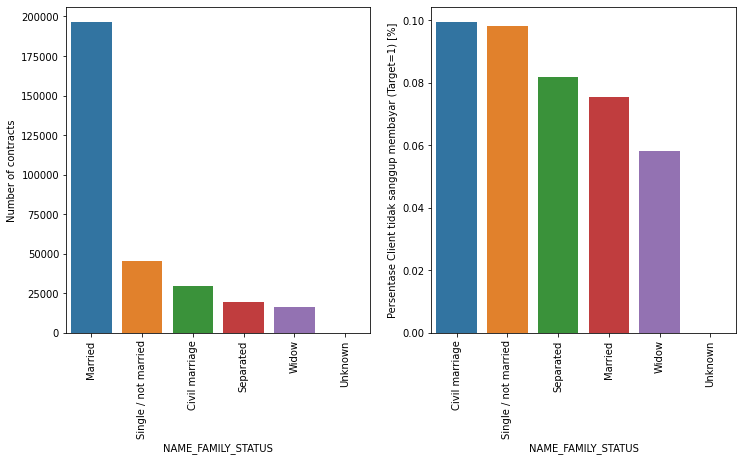

In [ ]:
#@title Perbandingan Status Hubungan Client
plot_stats('NAME_FAMILY_STATUS',True, True)

-Sebagian besar klien sudah menikah, diikuti Single/belum menikah dan Perkawinan sipil (*Civil Marriage*).

-Dalam hal persentase tidak dilunasi pinjaman, Perkawinan sipil memiliki persentase tidak dilunasi tertinggi (10%), dengan Janda yang terendah (pengecualian tidak diketahui).


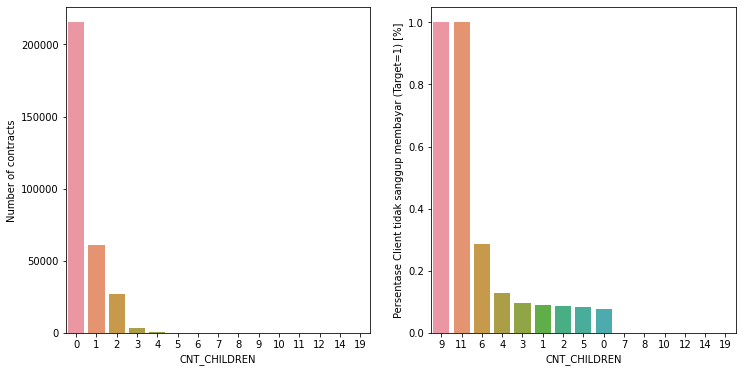

In [ ]:
#@title Perbandingan Jumlah Anak Client
plot_stats('CNT_CHILDREN')

Sebagian besar client tidak memiliki anak. 4 kali lebih besar,  dibandingkan dengan client yang memiliki 1 anak, dan 8 kali lebih banyak dari client yang memiliki 2 anak.
Kondisi client yang  memiliki anak sebanyak 3,4 atau lebih sangatlah jarang.

Untuk pelunasan, klien tanpa anak, 1, 2, 3, dan 5 anak memiliki persentase tidak melunasi rata-rata sekitar (10%). Klien dengan 4 dan 6 anak berada di atas rata-rata dalam hal persentase pinjaman yang tidak dibayar kembali (lebih dari 25% untuk keluarga dengan 6 anak).

Sedangkan untuk klien dengan 9 atau 11 anak, persentase pinjaman yang tidak dilunasi adalah 100%.


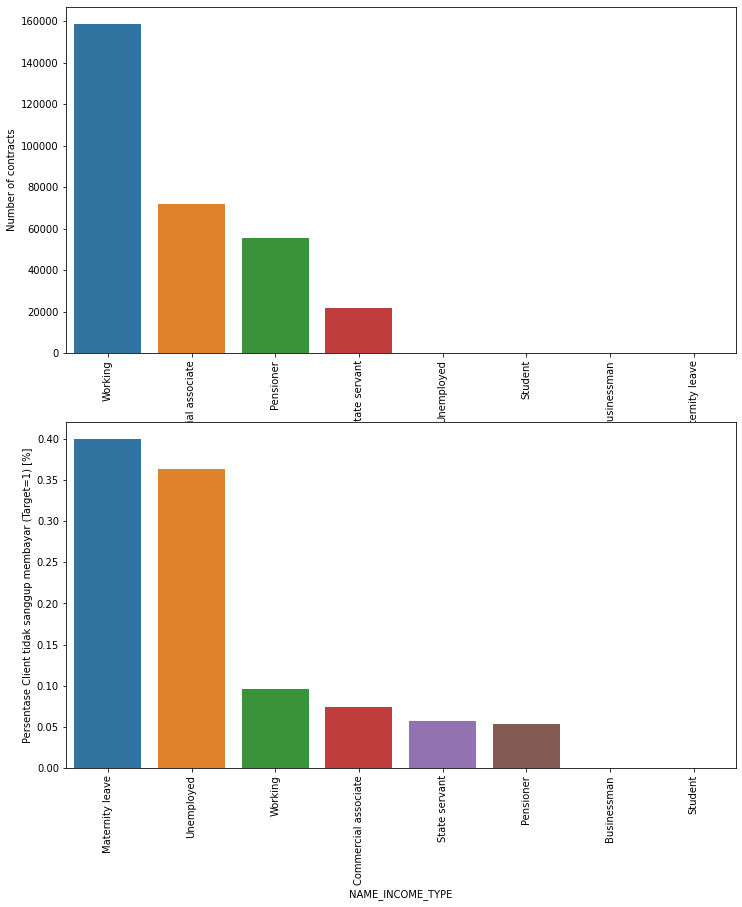

In [ ]:
#@title Perbandingan Sumber Pendapatan Client
plot_stats('NAME_INCOME_TYPE',True,False)

Sebagian besar pemohon pinjaman adalah yang berpenghasilan dari Bekerja, diikuti oleh Mitra Usaha, Pensiunan dan Pegawai Negeri Sipil.

Pemohon dengan jenis penghasilan Cuti melahirkan memiliki rasio tidak mengembalikan pinjaman hampir 40%, diikuti oleh Pengangguran (37%). Jenis pendapatan lainnya berada di bawah rata-rata 10% karena tidak mengembalikan pinjaman



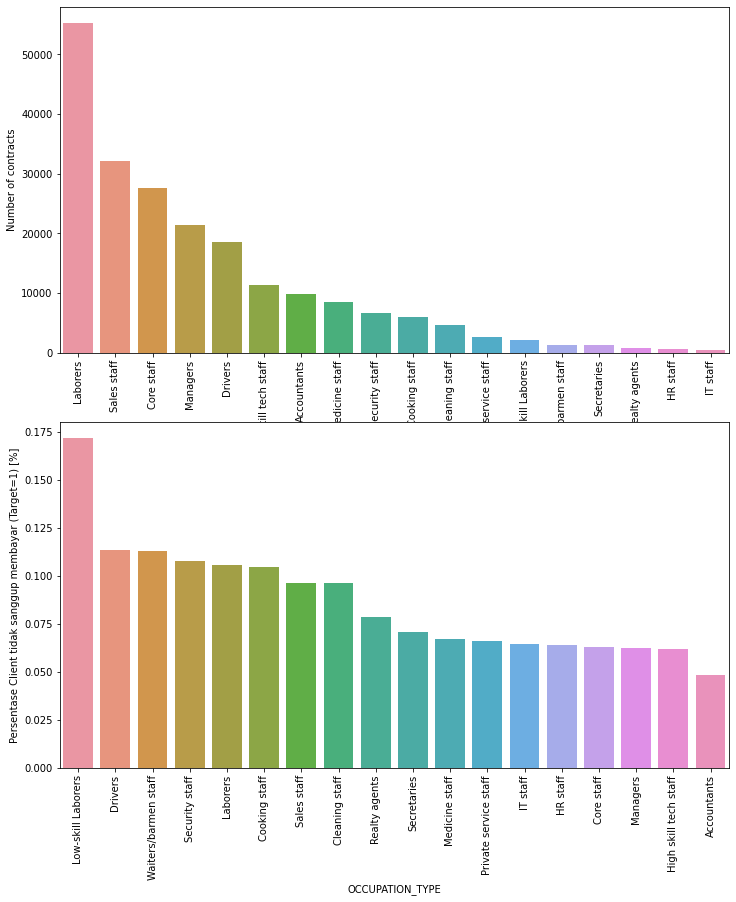

In [ ]:
#@title Perbandingan Jenis pekerjaan client
plot_stats('OCCUPATION_TYPE',True, False)

Sebagian besar pinjaman diambil oleh Buruh, diikuti oleh staf Penjualan. Staf TI mengambil jumlah pinjaman terendah.

Kategori dengan persentase pinjaman yang tidak dilunasi tertinggi adalah Tenaga Kerja Keterampilan Rendah (di atas 17%), diikuti oleh staf Pengemudi dan Pelayan/barmen, staf Keamanan, Tenaga Kerja dan staf Memasak.


# Data Preparation

Pada tahap ini kita akan melakukan persiapan terhadap data. Tahap ini sangat diperlukan untuk proses pemodelan nantinya.

## Persiapan Pertama

In [ ]:
# @title Memisahkan target dan data
df2_test = df_test.copy(deep=True)
df2_test.index += len(df_train)+1
train_index = df_train.index
test_index = df2_test.index

# Memisahkan kolom target
Y = df_train["TARGET"]
X = df_train.drop(columns=["TARGET"])



In [ ]:
# Temp
def get_train_test(df,y):
    train = list(set(train_index).intersection(df.index))
    test = list(set(test_index).intersection(df.index))
    return df.iloc[train], df.iloc[test], y.iloc[train]


In [ ]:
#@title Menggabungkan dataset training dan testing menjadi satu
# Tujuannya adalah untuk memudahkan cleaning
df = pd.concat([X,df2_test])
del(X)
del df2_test


In [ ]:
#@title Handling Duplicated Value
columns_without_id = [col for col in df.columns if col!='SK_ID_CURR']
#Checking for duplicates in the data.
df[df.duplicated(subset = columns_without_id, keep=False)]
print('The no of duplicates in the data:',df[df.duplicated(subset= columns_without_id, keep=False)]
      .shape[0])
del columns_without_id

The no of duplicates in the data: 0


##  Handling Different Data Types

In [ ]:
# Ubah kolom yang mengandung kata FLAG menjadi object
for _x in [i for i in df.columns if "FLAG" in i]:
    df[_x] = df[_x].apply(str)

## Feature Engineeering

Bagian ini adalah memilih atribut dalam dataset yang berguna untuk membangun model menjadi lebih baik.

In [ ]:
#@title Membuat fungsi utiltias
def aggregration_fnc(df,ID, COLS,type,table=""):
    COLS = COLS+[ID]
    agg= df[COLS].groupby(ID, as_index = False).agg(type).reset_index()
    # List of column names
    columns = [ID]

    # Iterate through the variables names
    for var in agg.columns.levels[0]:
        # Skip the id name
        if var != ID:

            # Iterate through the stat names
            for stat in agg.columns.levels[1][:-1]:
                # Make a new column name for the variable and stat
                columns.append('%s_%s_%s' % (var, stat.upper(),table))
    agg.columns = columns
    return agg

def merge_all(innit_df,list_df: list, index_key:str):
    df = innit_df.copy(deep=True)
    for dx in list_df:
        df = df.merge(dx, on=index_key, how='left')
    return df

def get_categorical_count(df,col,id,table=""):
    return pd.get_dummies(df[[id,col]]).groupby(id,as_index=False).sum().rename(columns = {col: col+"_"+table})

In [ ]:
#@title Olah Tabel Bureau Balance
df_bureau_balance = pd.read_csv("bureau_balance.csv")
bureau_balance = df_bureau_balance.groupby("SK_ID_BUREAU",as_index=False)["MONTHS_BALANCE"].min().rename(columns = {'MONTHS_BALANCE': 'OLDEST_MONTH_BALANCE'})
bureau_balance["MONTHS_BALANCE"] = 0
bureau_balance["CURR_BALANCE_STATUS"]= pd.merge(bureau_balance,df_bureau_balance, on=["SK_ID_BUREAU","MONTHS_BALANCE"], how='left' )["STATUS"]
del bureau_balance["MONTHS_BALANCE"]
del df_bureau_balance
gc.collect()
bureau_balance.sample()


,SK_ID_BUREAU,OLDEST_MONTH_BALANCE,CURR_BALANCE_STATUS
255284,5816779,-56,C


In [ ]:
#@title Olah tabel Bureau

# MENGGABUNGKAN DENGAN DATA LAMA
df_bureau = pd.read_csv("bureau.csv")
bureau = merge_all(df_bureau,[bureau_balance],"SK_ID_BUREAU")
bureau2 = get_categorical_count(bureau,'CURR_BALANCE_STATUS',"SK_ID_BUREAU")
bureau = merge_all(bureau,[bureau2],"SK_ID_BUREAU")


previous_loan_counts = bureau.groupby('SK_ID_CURR', as_index=False)['SK_ID_BUREAU'].count().rename(columns = {'SK_ID_BUREAU': 'bureau_previous_loan_CNT'})

credit_status = get_categorical_count(bureau,'CREDIT_ACTIVE',"SK_ID_CURR","bureau")
# MEDIAN, MAX
bureau_1 = aggregration_fnc(bureau,"SK_ID_CURR",[
    "AMT_CREDIT_MAX_OVERDUE","AMT_CREDIT_SUM","CURR_BALANCE_STATUS_5",
    "CURR_BALANCE_STATUS_1","CURR_BALANCE_STATUS_C"
    ],["median","max"],"bureau")
bureau_2 = aggregration_fnc(bureau,"SK_ID_CURR",["DAYS_CREDIT","CREDIT_DAY_OVERDUE"],["min","max"],"bureau")
# MIN, MAX
bureau = merge_all(previous_loan_counts,[credit_status,bureau_1,bureau_2],"SK_ID_CURR")
del previous_loan_counts
del credit_status
del bureau_1
del bureau_2
del bureau_balance
del df_bureau
bureau.sample()

,SK_ID_CURR,bureau_previous_loan_CNT,CREDIT_ACTIVE_Active,CREDIT_ACTIVE_Bad debt,CREDIT_ACTIVE_Closed,CREDIT_ACTIVE_Sold,AMT_CREDIT_MAX_OVERDUE_MEDIAN_bureau,AMT_CREDIT_MAX_OVERDUE_MAX_bureau,AMT_CREDIT_SUM_MEDIAN_bureau,AMT_CREDIT_SUM_MAX_bureau,CURR_BALANCE_STATUS_5_MEDIAN_bureau,CURR_BALANCE_STATUS_5_MAX_bureau,CURR_BALANCE_STATUS_1_MEDIAN_bureau,CURR_BALANCE_STATUS_1_MAX_bureau,CURR_BALANCE_STATUS_C_MEDIAN_bureau,CURR_BALANCE_STATUS_C_MAX_bureau,DAYS_CREDIT_MIN_bureau,DAYS_CREDIT_MAX_bureau,CREDIT_DAY_OVERDUE_MIN_bureau,CREDIT_DAY_OVERDUE_MAX_bureau
115782,234758,6,0,0,6,0,0.0,0.0,225000.0,1125000.0,0.0,0,0.0,0,0.0,0,-1235,-71,0,0


In [ ]:
#@title Olah Tabel Cash Balance
df_cash_balance = pd.read_csv('POS_CASH_balance.csv')
previous_loan_counts = df_cash_balance.groupby('SK_ID_CURR', as_index=False)['SK_ID_PREV'].count().rename(columns = {'SK_ID_PREV': 'HC_previous_loan_CNT'})
pos_cash = get_categorical_count(df_cash_balance[
    df_cash_balance.NAME_CONTRACT_STATUS.isin(["Active","Completed","Amortized debt"])],
                                 'NAME_CONTRACT_STATUS',"SK_ID_CURR","POS_cash")
# Cari yang statusnya active sama completed sama Amortized debt [DONE]
#Cari yang latest installemnt payment [DONE]
pos_cash["MONTHS_BALANCE"] = -1
pos_cash["LATEST_INSTALMENT"] = pd.merge(pos_cash,df_cash_balance,on=["SK_ID_CURR","MONTHS_BALANCE"],how='left')["CNT_INSTALMENT_FUTURE"]

pos_cash2 = aggregration_fnc(df_cash_balance,"SK_ID_CURR",["SK_DPD"],["min","median"],"cash")

pos_cash = merge_all(pos_cash,[previous_loan_counts,pos_cash2],"SK_ID_CURR")
del pos_cash["MONTHS_BALANCE"]
del previous_loan_counts
del df_cash_balance
del pos_cash2

print("var_name : pos_cash")
pos_cash.sample()

var_name : pos_cash


,SK_ID_CURR,NAME_CONTRACT_STATUS_Active,NAME_CONTRACT_STATUS_Amortized debt,NAME_CONTRACT_STATUS_Completed,LATEST_INSTALMENT,HC_previous_loan_CNT,SK_DPD_MIN_cash,SK_DPD_MEDIAN_cash
125029,232126,13.0,0.0,2.0,NaN,15,0,0.0


In [ ]:
#@title Olah tabel Credit Card Balance
df_CC_balance = pd.read_csv("credit_card_balance.csv")
cc_balance = get_categorical_count(df_CC_balance[
    df_CC_balance.NAME_CONTRACT_STATUS.isin(["Active","Completed","Refused"])],
                                 'NAME_CONTRACT_STATUS',"SK_ID_CURR","credit_card")
cc_balance2 = aggregration_fnc(df_CC_balance,"SK_ID_CURR",[
    "AMT_BALANCE","AMT_PAYMENT_TOTAL_CURRENT","AMT_RECIVABLE",
    "CNT_DRAWINGS_CURRENT", "AMT_DRAWINGS_CURRENT"
    ],["median","sum"],"credit_card")
cc_balance3 =  aggregration_fnc(df_CC_balance,"SK_ID_CURR",["SK_DPD"
    ],["min","median"],"credit_card")

cc_balance = merge_all(cc_balance,[cc_balance2,cc_balance3],"SK_ID_CURR")
del cc_balance2
del cc_balance3
del df_CC_balance
gc.collect()

print("var_name : cc_balance")
cc_balance.sample()

var_name : cc_balance


,SK_ID_CURR,NAME_CONTRACT_STATUS_Active,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_Refused,AMT_BALANCE_MEDIAN_credit_card,AMT_BALANCE_SUM_credit_card,AMT_PAYMENT_TOTAL_CURRENT_MEDIAN_credit_card,AMT_PAYMENT_TOTAL_CURRENT_SUM_credit_card,AMT_RECIVABLE_MEDIAN_credit_card,AMT_RECIVABLE_SUM_credit_card,CNT_DRAWINGS_CURRENT_MEDIAN_credit_card,CNT_DRAWINGS_CURRENT_SUM_credit_card,AMT_DRAWINGS_CURRENT_MEDIAN_credit_card,AMT_DRAWINGS_CURRENT_SUM_credit_card,SK_DPD_MIN_credit_card,SK_DPD_MEDIAN_credit_card
83282,385582,96,0,0,48191.85,4701835.575,18000.0,1572800.805,48191.85,4701363.435,0.0,65,0.0,1414128.87,0,0.0


In [ ]:
#@title Olah tabel Installment Payment
# INSTALLMENT_DATE = DAYS_ENTRY_PAYMENT - DAYS_INSTALMENT
# AMOUT INSTALLMENT MED, AMOUNT PAYMENT, MAX, MIN
df_inst_payment = pd.read_csv("installments_payments.csv")
inst_payment = df_inst_payment.copy(deep=True)
inst_payment["DAYS_TELAT_BAYAR"] = df_inst_payment.DAYS_ENTRY_PAYMENT - df_inst_payment.DAYS_INSTALMENT

inst_payment2 =  aggregration_fnc(inst_payment,"SK_ID_CURR",[
    "AMT_INSTALMENT","AMT_PAYMENT","DAYS_TELAT_BAYAR"],["median","max","min"],"installment")
inst_payment = merge_all(inst_payment2,[inst_payment2],"SK_ID_CURR")

del inst_payment2
del df_inst_payment
gc.collect()

print("var_name : inst_payment")
inst_payment.sample()

var_name : inst_payment


,SK_ID_CURR,AMT_INSTALMENT_MEDIAN_installment_x,AMT_INSTALMENT_MAX_installment_x,AMT_INSTALMENT_MIN_installment_x,AMT_PAYMENT_MEDIAN_installment_x,AMT_PAYMENT_MAX_installment_x,AMT_PAYMENT_MIN_installment_x,DAYS_TELAT_BAYAR_MEDIAN_installment_x,DAYS_TELAT_BAYAR_MAX_installment_x,DAYS_TELAT_BAYAR_MIN_installment_x,AMT_INSTALMENT_MEDIAN_installment_y,AMT_INSTALMENT_MAX_installment_y,AMT_INSTALMENT_MIN_installment_y,AMT_PAYMENT_MEDIAN_installment_y,AMT_PAYMENT_MAX_installment_y,AMT_PAYMENT_MIN_installment_y,DAYS_TELAT_BAYAR_MEDIAN_installment_y,DAYS_TELAT_BAYAR_MAX_installment_y,DAYS_TELAT_BAYAR_MIN_installment_y
324921,440905,12175.65,143146.755,6596.37,12175.65,143146.755,940.41,-15.0,4.0,-33.0,12175.65,143146.755,6596.37,12175.65,143146.755,940.41,-15.0,4.0,-33.0


In [ ]:
#@title Olah Tabel Application
df_prev_app = pd.read_csv("previous_application.csv")
prev_app = get_categorical_count(df_prev_app[
    df_prev_app.NAME_CONTRACT_TYPE.isin(["Cash loans","Consumer loans","Revolving loans"])],
                                 'NAME_CONTRACT_STATUS',"SK_ID_CURR","apply_prev")
prev_app2 =  aggregration_fnc(df_prev_app,"SK_ID_CURR",["AMT_CREDIT",
 "AMT_GOODS_PRICE",
 "AMT_APPLICATION", "RATE_DOWN_PAYMENT",
 "RATE_INTEREST_PRIMARY", "CNT_PAYMENT"],["median"],"apply_prev")

prev_app = merge_all(prev_app,[prev_app2],"SK_ID_CURR")
del prev_app2
del df_prev_app
gc.collect()

prev_app.sample()

,SK_ID_CURR,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Canceled,NAME_CONTRACT_STATUS_Refused,NAME_CONTRACT_STATUS_Unused offer,AMT_CREDIT_MEDIAN_apply_prev,AMT_GOODS_PRICE_MEDIAN_apply_prev,AMT_APPLICATION_MEDIAN_apply_prev,RATE_DOWN_PAYMENT_MEDIAN_apply_prev,RATE_INTEREST_PRIMARY_MEDIAN_apply_prev,CNT_PAYMENT_MEDIAN_apply_prev
271155,384830,1,0,0,0,87156.0,71959.5,71959.5,0.0,NaN,24.0


In [ ]:
AGG_DATASET = [bureau,pos_cash, cc_balance, inst_payment, prev_app ]

## Handling Null Value

In [ ]:
df = merge_all(df,AGG_DATASET, "SK_ID_CURR" )

In [ ]:
null_ratio(df,0)

,filled,N null,null_ratio(%)
RATE_INTEREST_PRIMARY_MEDIAN_apply_prev,5721,350534,98.394128
LATEST_INSTALMENT,90385,265870,74.629128
AMT_PAYMENT_TOTAL_CURRENT_MEDIAN_credit_card,103522,252733,70.941601
CNT_DRAWINGS_CURRENT_MEDIAN_credit_card,103522,252733,70.941601
NAME_CONTRACT_STATUS_Completed_y,103522,252733,70.941601
NAME_CONTRACT_STATUS_Refused_x,103522,252733,70.941601
AMT_BALANCE_MEDIAN_credit_card,103522,252733,70.941601
AMT_BALANCE_SUM_credit_card,103522,252733,70.941601
AMT_PAYMENT_TOTAL_CURRENT_SUM_credit_card,103522,252733,70.941601
AMT_RECIVABLE_MEDIAN_credit_card,103522,252733,70.941601


In [ ]:
NULL_TRESHOLD = 70

In [ ]:
# SIMPAN DULU VARIABELNYA DISINI
UNWANTED_COLUMN = ["SK_ID_CURR"]

# Kolom ini akan dihapus karena null nya melebihi 65%
UNWANTED_COLUMN.extend(null_ratio(df,NULL_TRESHOLD).index)

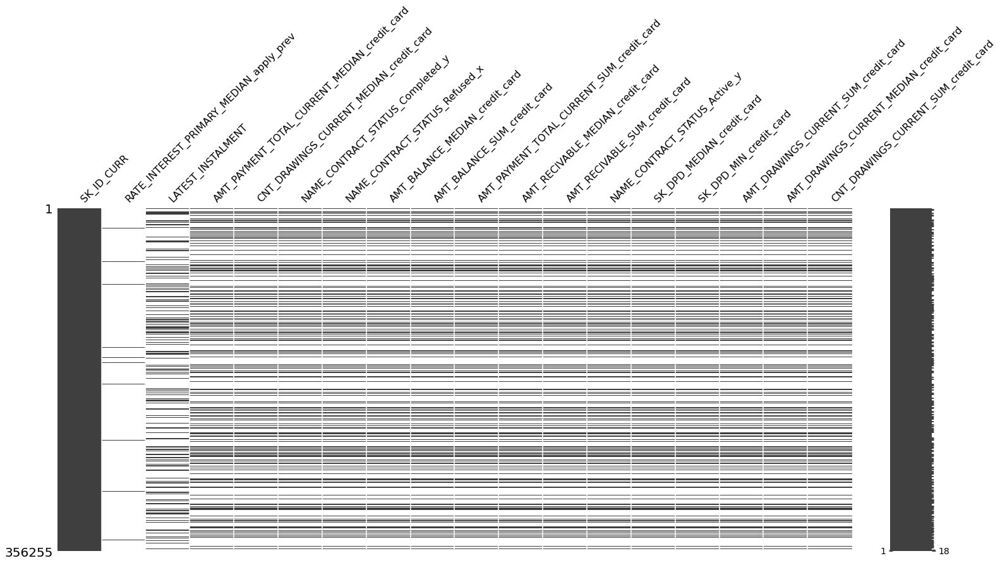

In [ ]:
#@title Kolom yang nullnya melebihi 70%
mnso.matrix(df[UNWANTED_COLUMN])

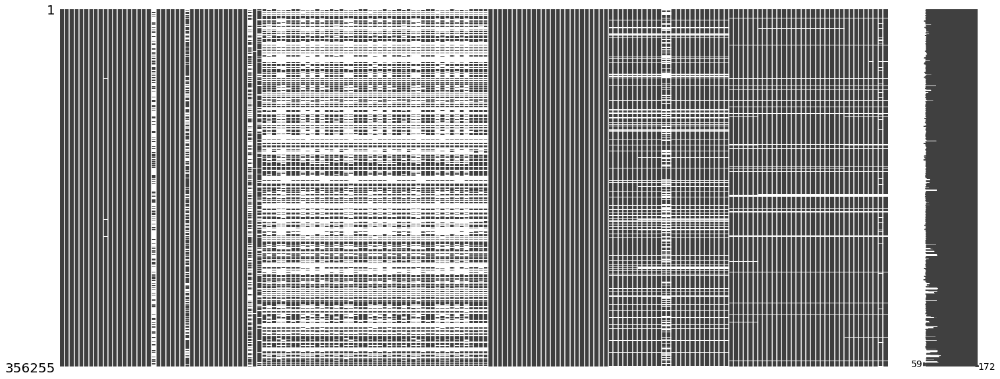

In [ ]:
#@title Bila dibandingkan dengan kolom lainnyna
mnso.matrix(df.loc[:,~df.columns.isin(UNWANTED_COLUMN)])

In [ ]:
from sklearn.impute import SimpleImputer

In [ ]:
#@title Fill Missing Value

def handling_missing(df,start_from=0, end_to=100):
    dn = null_ratio(df,start_from)
    for col in dn.index:
        nr  = float(dn.loc[col,'null_ratio(%)'])
        if  nr < end_to:
            # Kalau dia object diisi dengan modus
            if str(df[col].dtypes)=='object' :
                df[col] = df[col].fillna(df[col].mode()[0])
            # Kalau dia numerik diisi dengan median
            else:
                df[col] = df[col].fillna(df[col].median())

# def handling_missing(df,start_from=0, end_to=100):
#     dn = null_ratio(df,start_from)
#     obj_col = []
#     num_col = []

#     for col in dn.index:
#         nr  = float(dn.loc[col,'null_ratio(%)'])
#         if  nr < end_to:
#             if str(df[col].dtypes)=='object' :
#                 obj_col.append(col)
#             else:
#                 num_col.append(col)

#     df[obj_col] = SimpleImputer(missing_values=np.nan,
#                                  strategy='most_frequent').fit_transform(df[obj_col])
#     df[num_col] = SimpleImputer(missing_values=np.nan,
#                                  strategy='mean').fit_transform(df[num_col])

In [ ]:
handling_missing(df,end_to=NULL_TRESHOLD)

In [ ]:
df.head()

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,bureau_previous_loan_CNT,CREDIT_ACTIVE_Active,CREDIT_ACTIVE_Bad debt,CREDIT_ACTIVE_Closed,CREDIT_ACTIVE_Sold,AMT_CREDIT_MAX_OVERDUE_MEDIAN_bureau,AMT_CREDIT_MAX_OVERDUE_MAX_bureau,AMT_CREDIT_SUM_MEDIAN_bureau,AMT_CREDIT_SUM_MAX_bureau,CURR_BALANCE_STATUS_5_MEDIAN_bureau,CURR_BALANCE_STATUS_5_MAX_bureau,CURR_BALANCE_STATUS_1_MEDIAN_bureau,CURR_BALANCE_STATUS_1_MAX_bureau,CURR_BALANCE_STATUS_C_MEDIAN_bureau,CURR_BALANCE_STATUS_C_MAX_bureau,DAYS_CREDIT_MIN_bureau,DAYS_CREDIT_MAX_bureau,CREDIT_DAY_OVERDUE_MIN_bureau,CREDIT_DAY_OVERDUE_MAX_bureau,NAME_CONTRACT_STATUS_Active_x,NAME_CONTRACT_STATUS_Amortized debt,NAME_CONTRACT_STATUS_Completed_x,LATEST_INSTALMENT,HC_previous_loan_CNT,SK_DPD_MIN_cash,SK_DPD_MEDIAN_cash,NAME_CONTRACT_STATUS_Active_y,NAME_CONTRACT_STATUS_Completed_y,NAME_CONTRACT_STATUS_Refused_x,AMT_BALANCE_MEDIAN_credit_card,AMT_BALANCE_SUM_credit_card,AMT_PAYMENT_TOTAL_CURRENT_MEDIAN_credit_card,AMT_PAYMENT_TOTAL_CURRENT_SUM_credit_card,AMT_RECIVABLE_MEDIAN_credit_card,AMT_RECIVABLE_SUM_credit_card,CNT_DRAWINGS_CURRENT_MEDIAN_credit_card,CNT_DRAWINGS_CURRENT_SUM_credit_card,AMT_DRAWINGS_CURRENT_MEDIAN_credit_card,AMT_DRAWINGS_CURRENT_SUM_credit_card,SK_DPD_MIN_credit_card,SK_DPD_MEDIAN_credit_card,AMT_INSTALMENT_MEDIAN_installment_x,AMT_INSTALMENT_MAX_installment_x,AMT_INSTALMENT_MIN_installment_x,AMT_PAYMENT_MEDIAN_installment_x,AMT_PAYMENT_MAX_installment_x,AMT_PAYMENT_MIN_installment_x,DAYS_TELAT_BAYAR_MEDIAN_installment_x,DAYS_TELAT_BAYAR_MAX_installment_x,DAYS_TELAT_BAYAR_MIN_installment_x,AMT_INSTALMENT_MEDIAN_installment_y,AMT_INSTALMENT_MAX_installment_y,AMT_INSTALMENT_MIN_installment_y,AMT_PAYMENT_MEDIAN_installment_y,AMT_PAYMENT_MAX_installment_y,AMT_PAYMENT_MIN_installment_y,DAYS_TELAT_BAYAR_MEDIAN_installment_y,DAYS_TELAT_BAYAR_MAX_installment_y,DAYS_TE

In [ ]:
df_desc.query('Table.str.contains("train")', engine='python')

,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,"Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)",NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN
5,8,application_{train|test}.csv,FLAG_OWN_REALTY,Flag if client owns a house or flat,NaN
6,9,application_{train|test}.csv,CNT_CHILDREN,Number of children the client has,NaN
7,10,application_{train|test}.csv,AMT_INCOME_TOTAL,Income of the client,NaN
8,11,application_{train|test}.csv,AMT_CREDIT,Credit amount of the loan,NaN
9,12,application_{train|test}.csv,AMT_ANNUITY,Loan annuity,NaN


In [ ]:
UNWANTED_COLUMN.extend([
    "NAME_TYPE_SUITE", #Karena siapa yang mengantarkan client saat mendaftarkan
    # tidak terlalu penting dan berpengaruh pada prediksi
    "WEEKDAY_APPR_PROCESS_START", # Sudah ada tanggal pengajuan jadi kolom ini tidak teralu diperlukan

])


In [ ]:
# SISANYA TINGGAL DI DROP
df.drop(columns=UNWANTED_COLUMN,inplace=True)
gc.collect()

22

## EDA (lanjutan describe data)


visualisasi setelah cleaning

In [ ]:
df.tail()

In [ ]:
#@title Credit Distribution
def credit_dist(TARGET):
    df_,_,y = get_train_test(df,Y)
    plt.figure(figsize=(13,8))
    plt.title('Amount Client Credit'); plt.ylabel('Count');
    sns.histplot(data=df_, x=TARGET, kde=True)
    plt.plot()
    plt.figure(figsize=(13,8))
    plt.title('Amount Client Credit based on Target');plt.ylabel('Probabilty');
    sns.histplot(data=df_, x=TARGET,hue=Y, kde=True,element="poly",stat='probability')
    plt.plot()
credit_dist("AMT_CREDIT")

Distribusi total credit client terlihat left skewed. Selain itu client dengan nilai target 1 kemungkinan besar memiliki jumlah credit pada rentang 125000 - 725000.

In [ ]:
# @title Korelasi antar fitur numerikal
px.imshow(df.corr())

##  Preprocessing data

### Memisahkan dataset training dan testing

In [ ]:
print(train_index)
print(test_index)

RangeIndex(start=0, stop=307511, step=1)
RangeIndex(start=307512, stop=356256, step=1)


In [ ]:
df = pd.get_dummies(df,drop_first=True)

In [ ]:
df.shape

(356255, 268)

In [ ]:
df_X_train, df_X_test, Y1 = get_train_test(df,Y)

In [ ]:
# Untuk metrik pengukuran
# Ini untuk split train sama test yang bakalan dipake saat pengukuran metric error nanti

from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(df_X_train, Y1, test_size=0.33, random_state=42)

# Modelling & Evaluation

In [ ]:
# Untuk algoritma Regresinya
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.base import clone
# XGBoost
from xgboost import cv
from xgboost import XGBClassifier,DMatrix

# Ini untuk pengukuran metriknya
from sklearn.metrics import accuracy_score,ConfusionMatrixDisplay,roc_auc_score,confusion_matrix
from sklearn.model_selection import KFold,StratifiedKFold,RandomizedSearchCV
from sklearn.metrics import roc_curve, auc
import lightgbm as lgb
from sklearn.preprocessing import LabelEncoder

In [ ]:
print('Training Features Shape:', X_train.shape)
print('Training Labels Shape:', y_train.shape)
print('Testing Features Shape:', X_test.shape)
print('Testing Labels Shape:', y_test.shape)

Training Features Shape: (206032, 268)
Training Labels Shape: (206032,)
Testing Features Shape: (101479, 268)
Testing Labels Shape: (101479,)


In [ ]:
#@title Fungsi Utiltas
def metric_fnc(Model,train):
    Train = df_X_train.loc[train]
    print("Train Shape:",Train.shape)
    y_test  = Y1.loc[train]
    pred = Model.predict(Train)
    accuracy = accuracy_score(y_test,pred)
    fpr, tpr, auc_score = compute_roc_auc(Model,train)
    cm= confusion_matrix(y_test, pred)
    tn, fp, fn, tp =cm.ravel()
    pr = tp/(tp+fp)
    rc =tp/(tp+fn)

    sns.heatmap(cm/np.sum(cm), annot=True,
            fmt='.2%')
    print("Precision : ",pr)
    print("Recall : ",rc)
    print("F1 : ",(2*pr*rc)/pr+rc)
    print("Accuracy : ",(tp+tn)/(tp+tn+fp+fn))
    print("Specifify : ",(tn)/(tn+fp))
    fig = px.area(
        x=fpr, y=tpr,
        title=f'ROC Curve (AUC={auc_score:.4f})',
        labels=dict(x='False Positive Rate', y='True Positive Rate'),
        width=700, height=500
    )
    fig.add_shape(
        type='line', line=dict(dash='dash'),
        x0=0, x1=1, y0=0, y1=1
    )

    fig.update_yaxes(scaleanchor="x", scaleratio=1)
    fig.update_xaxes(constrain='domain')
    fig.show()
    try:

        plot = px.bar(x=Model.feature_importances_, y=df_X_train.columns).update_layout(barmode='stack', yaxis={'categoryorder':'total ascending'})
        plot.show()
    except:
        pass

def folds(Model,N_fold=5):
    model = clone(Model)
    cv = StratifiedKFold(n_splits=N_fold, random_state=123, shuffle=True)
    results = pd.DataFrame(columns=['training_score', 'test_score'])
    fprs, tprs, scores = [], [], []

    for (train, test), i in zip(cv.split(df_X_train, Y1), range(5)):
        model.fit(df_X_train.iloc[train], Y1.iloc[train])

        _, _, auc_score_train = compute_roc_auc(model,train)
        fpr, tpr, auc_score = compute_roc_auc(model,test)
        scores.append((auc_score_train, auc_score))
        fprs.append(fpr)
        tprs.append(tpr)


    return pd.DataFrame(scores, columns=['AUC Train', 'AUC Test']),train,test,model

def find_best_params(Model,hyperparam,N_fold=5):
    # https://www.projectpro.io/recipes/find-optimal-parameters-using-randomizedsearchcv-for-regression
    model = clone(Model)
    randm_src  = RandomizedSearchCV(model, hyperparam, random_state=0)
                                    # ,cv = N_fold, n_iter = 10)
    randm_src.fit(df_X_train, Y1)
    print("\n The best estimator across ALL searched params:\n", randm_src.best_estimator_)
    print("\n The best score across ALL searched params:\n", randm_src.best_score_)
    print("\n The best parameters across ALL searched params:\n", randm_src.best_params_)

def compute_roc_auc(clf,index):
    y_predict = clf.predict_proba(df_X_train.iloc[index])[:,1]
    fpr, tpr, thresholds = roc_curve(Y1.iloc[index], y_predict)
    auc_score = auc(fpr, tpr)
    return fpr, tpr, auc_score

### **Metric** lightgbm With Cross Validation

In [ ]:
def model(features, labels,test_features, encoding = 'ohe', n_folds = 5):

    print('Training Data Shape: ', features.shape)
    print('Testing Data Shape: ', test_features.shape)

    # Extract feature names
    feature_names = list(features.columns)

    # Convert to np arrays
    features = np.array(features)
    test_features = np.array(test_features)

    # Create the kfold object
    k_fold = KFold(n_splits = n_folds, shuffle = True, random_state = 50)

    # Empty array for feature importances
    feature_importance_values = np.zeros(len(feature_names))

    # Empty array for test predictions
    test_predictions = np.zeros(test_features.shape[0])

    # Empty array for out of fold validation predictions
    out_of_fold = np.zeros(features.shape[0])

    # Lists for recording validation and training scores
    valid_scores = []
    train_scores = []

    # Iterate through each fold
    for train_indices, valid_indices in k_fold.split(features):

        # Training data for the fold
        train_features, train_labels = features[train_indices], labels[train_indices]
        # Validation data for the fold
        valid_features, valid_labels = features[valid_indices], labels[valid_indices]

        # Create the model
        model = lgb.LGBMClassifier(n_estimators=10000, objective = 'binary',
                                   class_weight = 'balanced', learning_rate = 0.05,
                                   reg_alpha = 0.1, reg_lambda = 0.1,
                                   subsample = 0.8, n_jobs = -1, random_state = 50)

        # Train the model
        model.fit(train_features, train_labels, eval_metric = 'auc',
                  eval_set = [(valid_features, valid_labels), (train_features, train_labels)],
                  eval_names = ['valid', 'train'],
                  early_stopping_rounds = 100, verbose = 200)

        # Record the best iteration
        best_iteration = model.best_iteration_

        # Record the feature importances
        feature_importance_values += model.feature_importances_ / k_fold.n_splits

        # Make predictions
        test_predictions += model.predict_proba(test_features, num_iteration = best_iteration)[:, 1] / k_fold.n_splits

        # Record the out of fold predictions
        out_of_fold[valid_indices] = model.predict_proba(valid_features, num_iteration = best_iteration)[:, 1]

        # Record the best score
        valid_score = model.best_score_['valid']['auc']
        train_score = model.best_score_['train']['auc']

        valid_scores.append(valid_score)
        train_scores.append(train_score)

        # Clean up memory
        gc.enable()
        del train_features, valid_features
        gc.collect()

    # Make the submission dataframe

    # Make the feature importance dataframe
    feature_importances = pd.DataFrame({'feature': feature_names, 'importance': feature_importance_values})

    # Overall validation score
    valid_auc = roc_auc_score(labels, out_of_fold)

    # Add the overall scores to the metrics
    valid_scores.append(valid_auc)
    train_scores.append(np.mean(train_scores))

    # Needed for creating dataframe of validation scores
    fold_names = list(range(n_folds))
    fold_names.append('overall')

    # Dataframe of validation scores
    metrics = pd.DataFrame({'fold': fold_names,
                            'train': train_scores,
                            'valid': valid_scores}
                            )

    return  feature_importances, metrics, train_indices, valid_indices,model

In [ ]:
fi, metrics,train2,test2,lgboost_best = model(df_X_train,Y1, df_X_test,)
print('Baseline metrics')
print(metrics)

Training Data Shape:  (307511, 268)
Testing Data Shape:  (48743, 268)
Training until validation scores don't improve for 100 rounds.
[200]	train's auc: 0.814242	train's binary_logloss: 0.531973	valid's auc: 0.771169	valid's binary_logloss: 0.548669
[400]	train's auc: 0.84623	train's binary_logloss: 0.498158	valid's auc: 0.772413	valid's binary_logloss: 0.527494
Early stopping, best iteration is:
[415]	train's auc: 0.848458	train's binary_logloss: 0.495703	valid's auc: 0.772683	valid's binary_logloss: 0.525829
Training until validation scores don't improve for 100 rounds.
[200]	train's auc: 0.815046	train's binary_logloss: 0.531145	valid's auc: 0.769151	valid's binary_logloss: 0.548326
[400]	train's auc: 0.847255	train's binary_logloss: 0.496799	valid's auc: 0.769662	valid's binary_logloss: 0.527496
Early stopping, best iteration is:
[359]	train's auc: 0.841258	train's binary_logloss: 0.503195	valid's auc: 0.769786	valid's binary_logloss: 0.531375
Training until validation scores don't 

Train Shape: (246009, 268)
Precision :  0.20832309330711887
Recall :  0.7718925481863712
F1 :  2.3156776445591136
Accuracy :  0.7459727083155494
Specifify :  0.7437080648155515


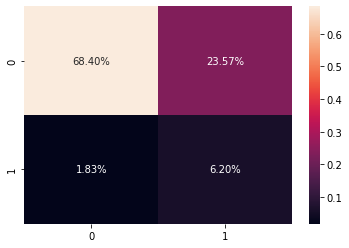

In [ ]:
metric_fnc(lgboost_best,train2)

### **Metric** XGBoost With Cross Validation

In [ ]:
params = {
        'objective':'binary:logistic',
        'max_depth': 4,
        'alpha': 10,
        'learning_rate': 1.0,
        'n_estimators':100
    }

M,xg_best_train,xg_best_test,xg_best = folds(XGBClassifier(**params))
print("5-Fold AUC Metric")
M.tail()

5-Fold AUC Metric


,AUC Train,AUC Test
0,0.831527,0.740320
1,0.833569,0.740350
2,0.831380,0.747905
3,0.832363,0.737736
4,0.833811,0.736300


Train Shape: (246009, 268)
Precision :  0.6352297592997812
Recall :  0.14617321248741189
F1 :  0.43851963746223566
Accuracy :  0.9242954526053925
Specifify :  0.9926287536093461


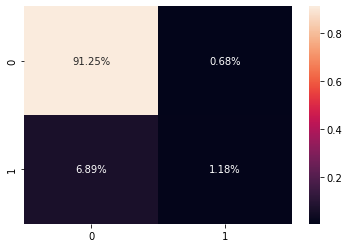

In [ ]:
metric_fnc(xg_best,xg_best_train)

### Random Forrest With Cross Validation

In [ ]:
rbc = RandomForestClassifier(
        n_estimators=50,
    criterion='gini',
    max_depth=5,
    min_samples_split=2,
    min_samples_leaf=1,
    max_features='auto',
    bootstrap=True,
    class_weight='balanced'
)
M,rfc_best_train,rfc_best_test,rfc_best= folds(rbc)
print("5-Fold AUC Metric")
M.tail()

5-Fold AUC Metric


,AUC Train,AUC Test
0,0.743259,0.734494
1,0.744530,0.733921
2,0.745455,0.739159
3,0.744627,0.737604
4,0.744533,0.730364


Train Shape: (246009, 268)
Precision :  0.15491522386722512
Recall :  0.6965256797583081
F1 :  2.0895770392749244
Accuracy :  0.6687600860131133
Specifify :  0.6663217613166541


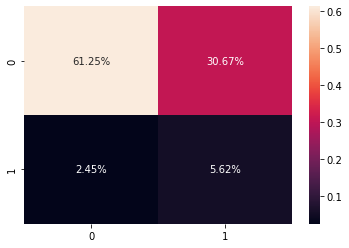

In [ ]:
metric_fnc(rfc_best,rfc_best_train)

Diatas Adalah Confusion Matrix

# Evaluation

Pada Metric diatas terlihat bahwa Model XGBoost memiliki nilai AUC  tinggi, yang disertai dengan nilai akurasi yang lebih tinggi daripada model lainnya. Oleh karena itu, model XGBoost dipilih sebagai model untuk prediksi.

# Deployment

In [ ]:
def predict(model,index):
    model.fit(df_X_train.iloc[index], Y1.iloc[index])
    return model.predict(df_X_test), model.predict_proba(df_X_test)


In [ ]:
# Cetak Dataset setelah cleaning
def output(model=None):
    df_X_train, df_X_test, Y1 = get_train_test(df,Y)
    if model:
        X = df_X_train.loc[:,[z for i,z in zip(model.feature_importances_,df_X_train.columns) if i>0]]
    else:
        X = df_X_train.copy(deep=True)
    X["ID"] = df_train["SK_ID_CURR"].loc[X.index]
    X["TARGET"] = Y1
    X.to_csv("output_train.csv",index=False)

def output_predict(model,index):
    X = df_X_test.copy(deep=True)
    pr = predict(model,index)
    print(pr[1])
    # X["SCORE"] = pr[1]
    # X["PRED"] = pr[0]

    # X.to_csv("output_predict.csv",index=False)

In [ ]:
output()

In [ ]:
output_predict(xg_best,xg_best_train)